$\textbf{Taller 4 Metodos Computacionales 2}$

$\textbf{Punto 1) Ecuación de Poisson en un disco}$

In [31]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from numba import njit

In [32]:
n = 500
x = np.linspace(-1.1 , 1.1, n)
y = np.linspace(-1.1, 1.1, n)
delta=abs(x[0]-x[1])

tolerancia = 1e-4
iter_max = 15000

phi = np.random.rand(n, n)

for i in range(n):
    for j in range(n):
        r=np.sqrt(x[i]**2+y[j]**2)
        if r>=1:
            theta=np.arctan2(y[j], x[i])
            phi[i,j]=np.sin(7*theta)
        

In [33]:
@njit
def iterar_poisson(phif, x, y, n, delta, tol, iter_max):
    for iteration in range(iter_max):
        phi_old = phif.copy()
        for i in range(1, n-1):
            for j in range(1, n-1):
                r = np.sqrt(x[i]**2 + y[j]**2)
                if r < 1:  
                    phif[i, j] = (phi_old[i+1, j] + phi_old[i-1, j] + phi_old[i, j+1] + phi_old[i, j-1] + 4 * np.pi * (-x[i] - y[j]) * delta**2) / 4
        
        error = np.abs(phif - phi_old).max() 
        if error < tol:
            break
    return phif

In [34]:
phi = iterar_poisson(phi, x, y, n, delta, tolerancia, iter_max)

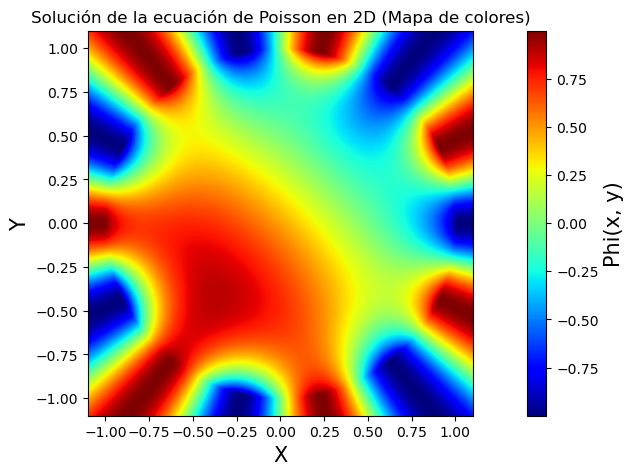

In [35]:
plt.figure()
plt.imshow(phi, extent=[x.min(), x.max(), y.min(), y.max()], origin='lower', cmap='jet')

# Añadir una barra de colores para indicar el valor de phi
plt.colorbar(label='Phi(x, y)')

# Etiquetas de los ejes
plt.xlabel('X')
plt.ylabel('Y')
plt.title('Solución de la ecuación de Poisson en 2D (Mapa de colores)')

# Mostrar la gráfica
plt.show()

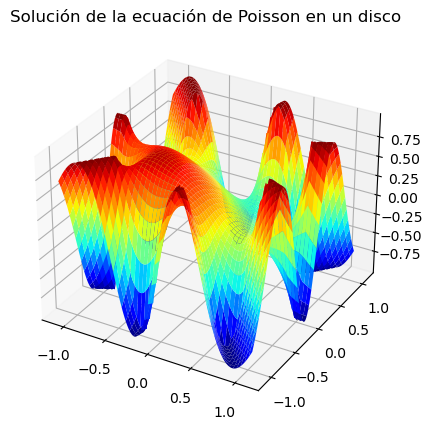

In [36]:
X, Y = np.meshgrid(x, y)  
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')


ax.plot_surface(X, Y, phi, cmap='jet')


ax.set_title('Solución de la ecuación de Poisson en un disco')

plt.show()
    

$\textbf{Punto 2) Ecuación de onda unidimensional}$

In [37]:
import matplotlib.animation as animation
plt.rcParams["axes.labelsize"] = 15
plt.rcParams["figure.figsize"] = (14,5)
plt.rcParams["animation.html"] = "jshtml"

In [38]:
L = 2
T = 1      
c = 1
dx = 0.01    
dt = 0.005
nx=int(L/dx)
nt=int(T/dt)

C=c*dt/dx 

x = np.arange(0,L,dx)



In [39]:
def PDE_onda(arr,condicion):
    arr[0]=np.exp(-125*(x-1/2)**2)
    arr[0]=condicion(arr[0])
    for i in range (1,nx-1):
        arr[1,i]=arr[0, i]+0.5*C**2*(arr[0,i+1]-2*arr[0,i]+arr[0,i-1])
    arr[1]=condicion(arr[1])
    
    for n in range(1, nt-1): 
        for i in range(1, nx-1): 
            arr[n+1, i] = 2 * arr[n, i] - arr[n-1, i] + C**2 * (arr[n, i+1] - 2 * arr[n, i] + arr[n, i-1])
        arr[n+1]=condicion(arr[n+1])
    
    return arr

def Dirichlet(arr):
    arr[0] = 0
    arr[-1] = 0
    return arr

def Neumann(arr):
    arr[0] =  arr[1]
    arr[-1] = arr[-2]
    return arr

def Periodica(arr):
    arr[0] = arr[-2]
    arr[-1] = arr[1]
    return arr

U_Dirichlet = np.zeros( (nt,nx) ) * np.nan
U_Neumann = np.zeros( (nt,nx) ) * np.nan
U_Periodica = np.zeros( (nt,nx) ) * np.nan

U_Dirichlet=PDE_onda(U_Dirichlet,Dirichlet)
U_Neumann=PDE_onda(U_Neumann,Neumann)
U_Periodica=PDE_onda(U_Periodica,Periodica)



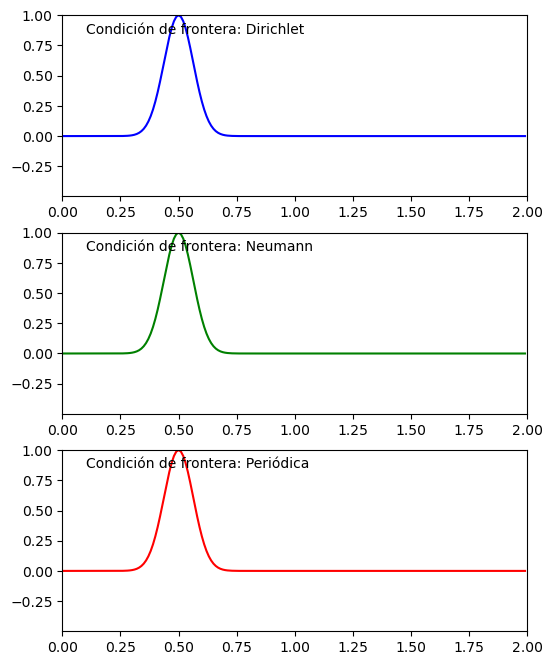

In [40]:
fig, axs = plt.subplots(3, 1, figsize=(6, 8))
for ax in axs:
    ax.set_xlim(0, L)
    ax.set_ylim(np.min(U_Dirichlet), np.max(U_Dirichlet))
    
line_dirichlet, = axs[0].plot(x, U_Dirichlet[0], 'b')
line_neumann, = axs[1].plot(x, U_Neumann[0], 'g')
line_periodic, = axs[2].plot(x, U_Periodica[0], 'r')

axs[0].text(0.05, 0.9, 'Condición de frontera: Dirichlet', transform=axs[0].transAxes)
axs[1].text(0.05, 0.9, 'Condición de frontera: Neumann', transform=axs[1].transAxes)
axs[2].text(0.05, 0.9, 'Condición de frontera: Periódica', transform=axs[2].transAxes)

def draw_frame(frame):
    line_dirichlet.set_ydata(U_Dirichlet[frame])
    line_neumann.set_ydata(U_Neumann[frame])
    line_periodic.set_ydata(U_Periodica[frame])
    return line_dirichlet, line_neumann, line_periodic

anim = animation.FuncAnimation(fig, draw_frame, frames=range(nt), interval=50, blit=False)




In [41]:
anim

$\textbf{Punto 3) Ondas no lineales, plasma y fluidos}$

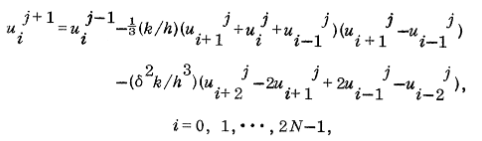

In [80]:
T3 = 2
alpha = 0.022
dt3 = 0.0001
nx3=200
nt3=int(T3/dt3)
dx3=2/nx3

x3 = np.linspace(0,2,nx3)



20000

In [81]:


U3=np.zeros( (nt3,nx3) )

U3[0]=np.cos(np.pi*x3)

for i in range(nx3): 
    U3[1, i] = U3[0, i] - 1/3 * dt3/dx3 * (U3[0, np.mod(i+1, nx3)] + U3[0, i] + U3[0, np.mod(i-1, nx3)]) * (U3[0, np.mod(i+1, nx3)] - U3[0, np.mod(i-1, nx3)])- (alpha**2) * (dt3/(dx3)**3) * (U3[0, np.mod(i+2, nx3)] - 2*U3[0, np.mod(i+1, nx3)] + 2*U3[0, np.mod(i-1, nx3)] - U3[0, np.mod(i-2, nx3)])
    


In [82]:
@njit
def interar3(Urr, veces, nx3, dt3, dx3, alpha):
    for n in range(1,veces-1): 
        for i in range(nx3): 
            Urr[n+1, i] = Urr[n-1, i] - 1/3 * dt3/dx3 * (Urr[n, np.mod(i+1, nx3)] + Urr[n, i] + Urr[n, np.mod(i-1, nx3)]) * (Urr[n, np.mod(i+1, nx3)] - Urr[n, np.mod(i-1, nx3)])- (alpha**2) * (dt3/(dx3)**3) * (Urr[n, np.mod(i+2, nx3)] - 2*Urr[n, np.mod(i+1, nx3)] + 2*Urr[n, np.mod(i-1, nx3)] - Urr[n, np.mod(i-2, nx3)])
    return Urr

In [83]:
U3=interar3(U3, nt3, nx3, dt3, dx3, alpha)

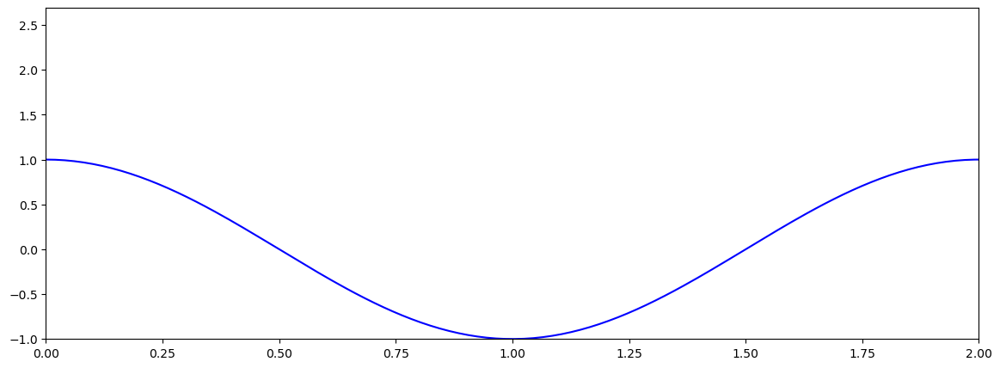

In [84]:

fig = plt.figure()
ax = plt.axes(xlim=(0, 2), ylim=(np.min(U3), np.max(U3)))
point, = ax.plot(x3, U3[0], 'b')  # Inicializar el gráfico con el primer frame

# Función para actualizar la gráfica en cada frame
def draw_frame(frame):
    point.set_ydata(U3[frame])  # Actualiza los valores de y con el frame actual
    return point

# Crear la animación para graficar cada 10 frames
anim3 = animation.FuncAnimation(fig, draw_frame, frames=range(0, len(U3),200), interval=50, blit=False)


In [85]:
anim3


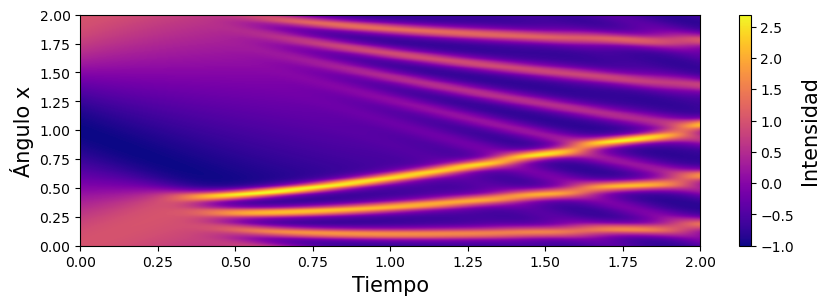

In [87]:
t3 = np.linspace(0, T3, nt3) 
plt.figure(figsize=(10, 3))
plt.imshow(U3.T, aspect='auto', cmap='plasma', origin='lower',
           extent=[t3.min(), t3.max(), x3.min(), x3.max()])
plt.colorbar(label='Intensidad')
plt.xlabel('Tiempo')
plt.ylabel('Ángulo x')

plt.show()

$\textbf{Punto 4) Ecuación de onda bidimensional}$

In [200]:

Lx4 = 2     
Ly4 = 1     
dx4 = 0.01  
dy4 = 0.01  
dt4 = 0.005 
c4 = 0.5  

T4=3
   

nx4 = int(Lx4 / dx4)
ny4 = int(Ly4 / dy4)
nt4 = int(T4 / dt4)


x4 = np.linspace(0, Lx4, nx4)
y4 = np.linspace(0, Ly4, ny4)



ind_pax1 = int((1-0.02) / dx4) 
ind_pax2 = int((1+0.02) / dx4)  
ind_pay1 = int(0.42 / dy4)  
ind_pay2 = int((1-0.42) / dy4)   



In [201]:
def Dirichlet(arr):
    arr[0,:] = 0
    arr[-1,:] = 0
    arr[:,0] = 0
    arr[:,-1] = 0
    arr[ind_pax1-1:ind_pax2+1,:ind_pay1+1]=0
    arr[ind_pax1-1:ind_pax2+1,ind_pay2-1:]=0
    return arr

U4D=np.zeros((nt4,nx4,ny4))

for i in range(nx4):
    for j in range(ny4):
        U4D[0,i,j]=2*np.exp(-150*((x4[i]-2/5)**2+(y4[j]-1/2)**2))
        
U4D[0]=Dirichlet(U4D[0])

for i in range(1, nx4-1):
        for j in range(1, ny4-1):
            U4D[1, i, j] = U4D[0, i, j] + 0.5 * (c4*dt4)**2 *((U4D[0, i+1, j] - 2*U4D[0, i, j] + U4D[0, i-1, j]) / dx4**2 + (U4D[0, i, j+1] - 2*U4D[0, i, j] + U4D[0, i, j-1]) / dy4**2)

U4D[1]=Dirichlet(U4D[1])
        


In [202]:
@njit

def evol(U4D,itermax,ind_pax1,ind_pax2,ind_pay1,ind_pay2):
    for n in range(1,itermax): 
        for i in range(1, nx4-1):
                for j in range(1, ny4-1):
                    U4D[n+1, i, j] = 2*U4D[n, i, j]-U4D[n-1, i, j] + (c4*dt4)**2 *((U4D[n, i+1, j] - 2*U4D[n, i, j] + U4D[n, i-1, j]) / dx4**2 + (U4D[n, i, j+1] - 2*U4D[n, i, j] + U4D[n, i, j-1]) / dy4**2)
        U4D[n+1,0,:] = 0
        U4D[n+1,-1,:] = 0
        U4D[n+1,:,0] = 0
        U4D[n+1,:,-1] = 0
        U4D[n+1,ind_pax1-1:ind_pax2+1,:ind_pay1+1]=0
        U4D[n+1,ind_pax1-1:ind_pax2+1,ind_pay2-1:]=0
    return U4D

In [203]:
U4D=evol(U4D,nt4-1,ind_pax1,ind_pax2,ind_pay1,ind_pay2)

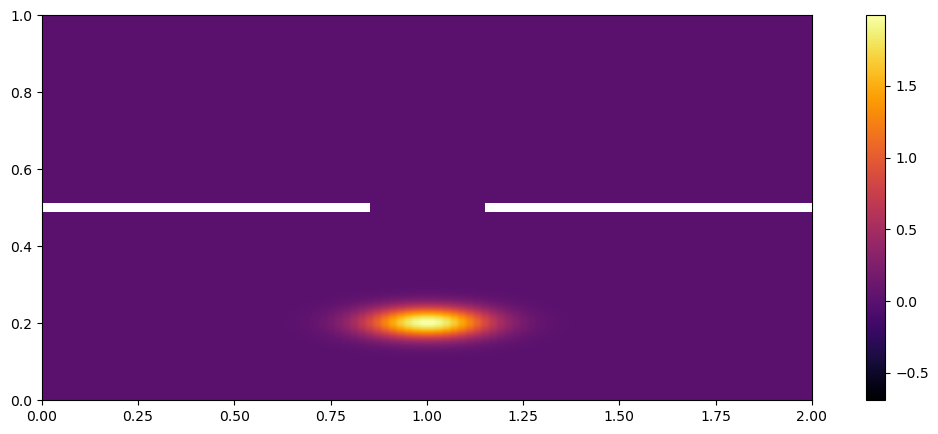

In [222]:
fig, ax = plt.subplots()

ax.set_xlim(0, 2)  
ax.set_ylim(0, 1)  

mask = np.zeros((nx4, ny4), dtype=bool)
mask[ind_pax1:ind_pax2,:ind_pay1] = True 
mask[ind_pax1:ind_pax2,ind_pay2:] = True  


cmap = ax.imshow(U4D[0], extent=[0, 2, 0, 1], origin='lower', cmap='inferno', vmin=np.min(U4D), vmax=np.max(U4D))
fig.colorbar(cmap)  


def draw_frame(frame):
    
    frame_data = U4D[frame].copy()
    
 
    frame_data[mask] = np.nan  
    
    cmap.set_array(frame_data)
    return [cmap]

anim = animation.FuncAnimation(fig, draw_frame, frames=range(0, len(U4D), 10), interval=50, blit=False)


In [223]:
anim